In [1]:
#Importing some essential libriaries on Python
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

SEED = 28 # specify seed for reproducable results

In [2]:
df = pd.read_csv("high_diamond_ranked_10min.csv")

In [3]:
(df.head())


,gameId,blueWins,blueWardsPlaced,blueWardsDestroyed,blueFirstBlood,blueKills,blueDeaths,blueAssists,blueEliteMonsters,blueDragons,...,redTowersDestroyed,redTotalGold,redAvgLevel,redTotalExperience,redTotalMinionsKilled,redTotalJungleMinionsKilled,redGoldDiff,redExperienceDiff,redCSPerMin,redGoldPerMin
0,4519157822,0,28,2,1,9,6,11,0,0,...,0,16567,6.8,17047,197,55,-643,8,19.7,1656.7
1,4523371949,0,12,1,0,5,5,5,0,0,...,1,17620,6.8,17438,240,52,2908,1173,24.0,1762.0
2,4521474530,0,15,0,0,7,11,4,1,1,...,0,17285,6.8,17254,203,28,1172,1033,20.3,1728.5
3,4524384067,0,43,1,0,4,5,5,1,0,...,0,16478,7.0,17961,235,47,1321,7,23.5,1647.8
4,4436033771,0,75,4,0,6,6,6,0,0,...,0,17404,7.0,18313,225,67,1004,-230,22.5,1740.4


In [4]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
gameId,9879.0,4.500084e+09,2.757328e+07,4.295358e+09,4.483301e+09,4.510920e+09,4.521733e+09,4.527991e+09
blueWins,9879.0,4.990384e-01,5.000244e-01,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00,1.000000e+00
blueWardsPlaced,9879.0,2.228829e+01,1.801918e+01,5.000000e+00,1.400000e+01,1.600000e+01,2.000000e+01,2.500000e+02
blueWardsDestroyed,9879.0,2.824881e+00,2.174998e+00,0.000000e+00,1.000000e+00,3.000000e+00,4.000000e+00,2.700000e+01
blueFirstBlood,9879.0,5.048082e-01,5.000022e-01,0.000000e+00,0.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00
blueKills,9879.0,6.183925e+00,3.011028e+00,0.000000e+00,4.000000e+00,6.000000e+00,8.000000e+00,2.200000e+01
blueDeaths,9879.0,6.137666e+00,2.933818e+00,0.000000e+00,4.000000e+00,6.000000e+00,8.000000e+00,2.200000e+01
blueAssists,9879.0,6.645106e+00,4.064520e+00,0.000000e+00,4.000000e+00,6.000000e+00,9.000000e+00,2.900000e+01
blueEliteMonsters,9879.0,5.499544e-01,6.255265e-01,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00,2.000000e+00
blueDragons,9879.0,3.619800e-01,4.805974e-01,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00,1.000000e+00


In [5]:
df.dtypes

gameId                            int64
blueWins                          int64
blueWardsPlaced                   int64
blueWardsDestroyed                int64
blueFirstBlood                    int64
blueKills                         int64
blueDeaths                        int64
blueAssists                       int64
blueEliteMonsters                 int64
blueDragons                       int64
blueHeralds                       int64
blueTowersDestroyed               int64
blueTotalGold                     int64
blueAvgLevel                    float64
blueTotalExperience               int64
blueTotalMinionsKilled            int64
blueTotalJungleMinionsKilled      int64
blueGoldDiff                      int64
blueExperienceDiff                int64
blueCSPerMin                    float64
blueGoldPerMin                  float64
redWardsPlaced                    int64
redWardsDestroyed                 int64
redFirstBlood                     int64
redKills                          int64


The first step is to visually inspect the intial Dataset. 
We can see that there are a total of 9879 instances out of which 4930 results in the BlueTeam winning and 4949 results in the RedTeam winning. 
The distribution of the data is 49.9% BlueWin and 50.1% RedWins.
The data distribution is basically a 50% and 50% split, so it can be considered an almost perfect balanced dataset. 
Given that, no sampling strategy has to be applied. Moreover we check for the presence of any missing values and there is no missing value in the dataset.

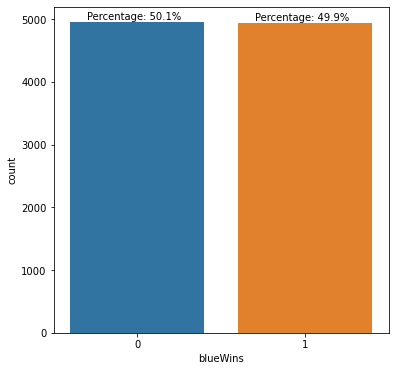

In [6]:
%matplotlib inline

#splot = sns.countplot(data=df, x = 'blueWins' )
plt.figure(figsize=(6,6))
ax = sns.countplot(x="blueWins", data=df)
#without_hue(ax,df.blueWins)

for p in ax.patches:
        ax.annotate('Percentage: {:.1f}%'.format((p.get_height()/9879)*100), (p.get_x()+0.1, p.get_height()+50))
        


In [7]:
#Check the NAs number for each dataset attribute
print(df.isnull().sum())

gameId                          0
blueWins                        0
blueWardsPlaced                 0
blueWardsDestroyed              0
blueFirstBlood                  0
blueKills                       0
blueDeaths                      0
blueAssists                     0
blueEliteMonsters               0
blueDragons                     0
blueHeralds                     0
blueTowersDestroyed             0
blueTotalGold                   0
blueAvgLevel                    0
blueTotalExperience             0
blueTotalMinionsKilled          0
blueTotalJungleMinionsKilled    0
blueGoldDiff                    0
blueExperienceDiff              0
blueCSPerMin                    0
blueGoldPerMin                  0
redWardsPlaced                  0
redWardsDestroyed               0
redFirstBlood                   0
redKills                        0
redDeaths                       0
redAssists                      0
redEliteMonsters                0
redDragons                      0
redHeralds    

#Data Visaulization

- Histogram
- Correlation Matrix
- Box Plots

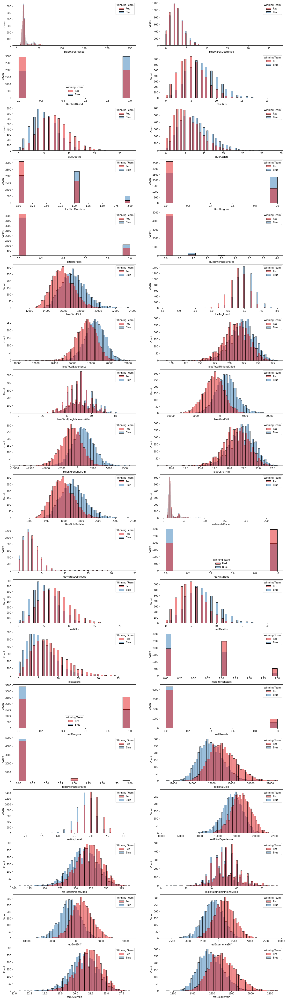

In [8]:
#Histogram
fig, axes = plt.subplots(19, 2, figsize=(20, 75))
n=1

for k in range(19):
    for v in range(2):
        n = n+1;
        bx = sns.histplot(ax=axes[k, v], data=df,x = df.columns[n], hue="blueWins", palette="Set1")
        
        leg = bx.axes.get_legend()
        new_title = 'Winning Team'
        leg.set_title(new_title)
        new_labels = ['Red', 'Blue']
        for t, l in zip(leg.texts, new_labels): t.set_text(l)
      

Most of the features are overlapped. As we can see, a lot of histograms are specular or identical (examples below), leading to redundancy of the data, because of that we decided to drop one feature for each couple.
We expected already that some histograms would have been like that because of the structure of the game itself, it's clear that the number of kills done by one team are equals to the deaths of the other team.
Moreover, at a first sight, the gold and experience difference seems to be the most important features on influencing the winning team.

We also drop "gameId" because it gives no information about the game.

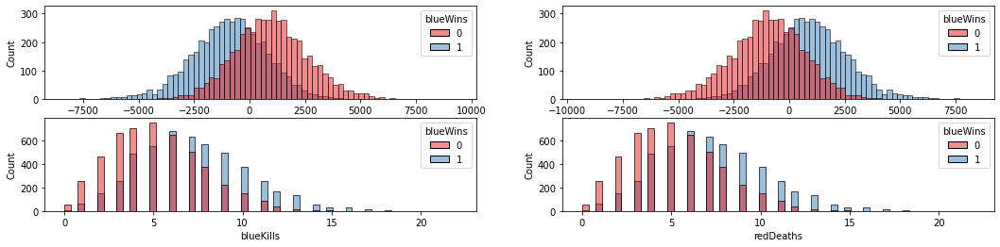

In [9]:
#confronto 
fig, axes = plt.subplots(2, 2, figsize=(18, 4))
ax = sns.histplot(ax=axes[0 , 0], data=df,x = "redExperienceDiff", hue="blueWins", palette="Set1")
bx = sns.histplot(ax=axes[0, 1], data=df,x = "blueExperienceDiff", hue="blueWins", palette="Set1")
cx = sns.histplot(ax=axes[1, 0], data=df,x = "blueKills", hue="blueWins", palette="Set1")
dx = sns.histplot(ax=axes[1, 1], data=df,x = "redDeaths", hue="blueWins", palette="Set1")

In [6]:
#Drop
#Select the attributes of interest to our analysis
df_v2 = df.drop([ "gameId",
                  "redFirstBlood",
                  "redKills",
                  "redDeaths",
                  "redGoldDiff",
                  "redExperienceDiff"], axis = 1)


In order to understand the correlation between the features we plotted the correlation matrix. A correlation Matrix is a table showing the correlation coefficient between the variables. Each cell in the table shows the correlation between the two variables. The correlated features provide redundant information. By avoiding highly correlated features we can avoid positive bias for the information contained in these features.

This also shows us, that when we want to make statements about the importance of a specific feature, we need to keep in mind that just because they are suitable to predict an outcome they are not necessarily causal - they could simply be correlated with casual factors.

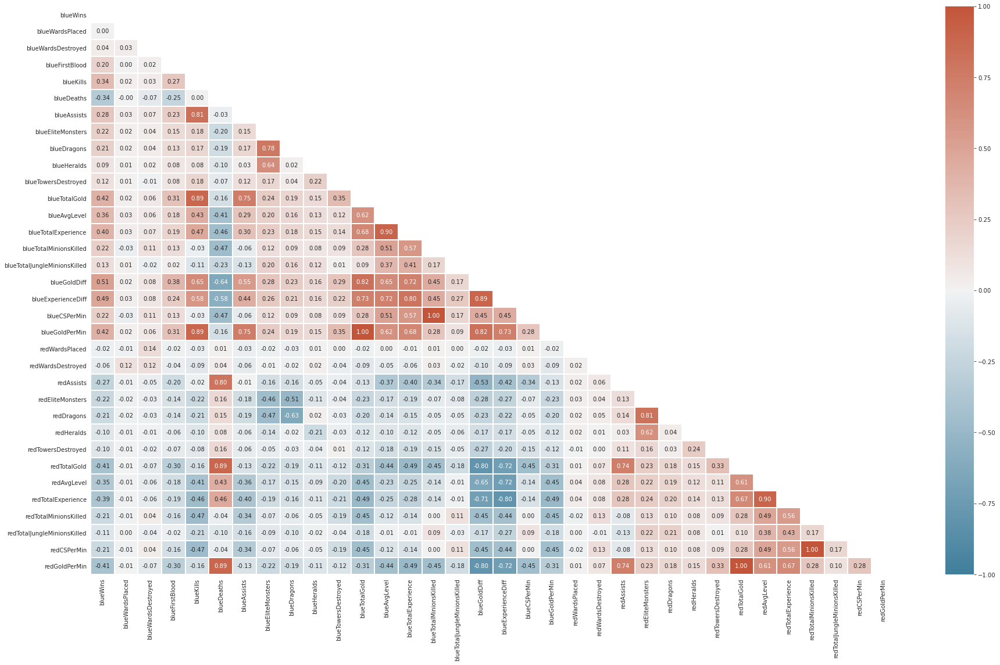

In [11]:
#Correlation Matrix
cmap = sns.diverging_palette(230, 20, as_cmap=True)
mask = np.zeros_like(df_v2.corr())
mask[np.triu_indices_from(mask)] = True
with sns.axes_style("white"):
    f, ax = plt.subplots(figsize=(31, 18))
    ax = sns.heatmap(df_v2.corr(), 
                      mask=mask, linewidths = 1, vmin=-1, cmap= cmap, annot=True, fmt ='.2f')


In [7]:
#Drop Variabili
#Select the attributes of interest to our analysis
df_v3 = df_v2.drop([ "blueGoldPerMin",
                  "blueCSPerMin",
                  "redGoldPerMin",
                  "redCSPerMin",
                  "blueTotalExperience",
                  "redTotalExperience",
                  "blueWardsPlaced",
                  "blueWardsDestroyed",
                  "blueHeralds",
                  "blueTowersDestroyed",
                  "blueTotalJungleMinionsKilled",
                  "redWardsPlaced",
                  "redWardsDestroyed",
                  "redHeralds",
                  "redTowersDestroyed", 
                  "redTotalJungleMinionsKilled"  
                 ], axis = 1)

All the features are numerical and the boxplots allow us to view the differences in the 
range of values that exist between the various features.
One boxplot shows a box delimited by the first quartile (25%) and third quartile (75%) of the values.
Other values depicted are the median of values (second quartile) and the minimum and maximum values (The black lines "baffi).
Moreover, the representation of outliers is very interesting and can help on the decision to drop or not some features.
The boxplots of the 27 remaining features are the following:

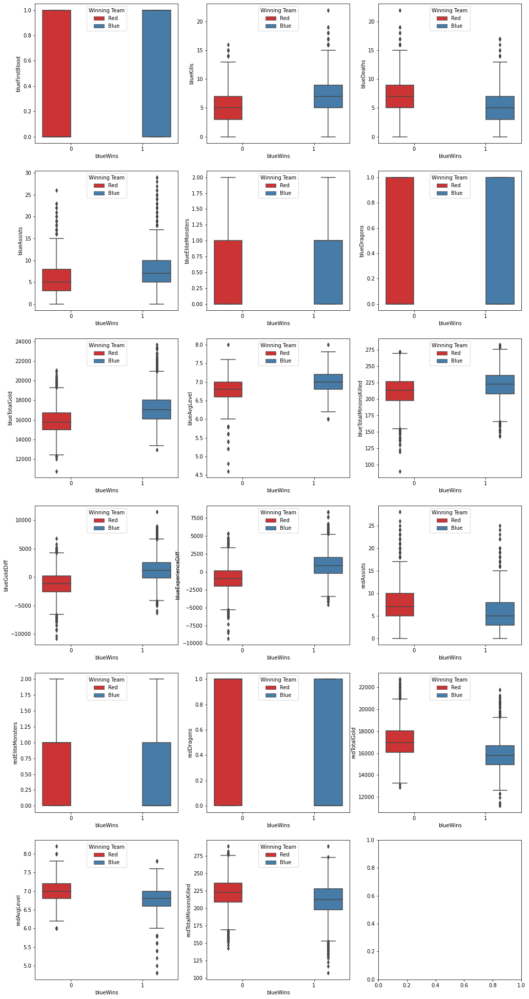

In [13]:
#Boxplots da fixare, diventano 17
fig, axes = plt.subplots(6, 3, figsize=(17, 35))
n=0

for k in range(6):
    for v in range(3):
        n = n+1;
        if k == 5 and v == 2:
            break
        else:
            bx = sns.boxplot(ax=axes[k, v], data=df_v3, x='blueWins', y = df_v3.columns[n], hue="blueWins", palette="Set1")
            bx.legend(loc = "upper center")
            leg = bx.axes.get_legend()
            new_title = 'Winning Team'
            leg.set_title(new_title)
            new_labels = ['Red', 'Blue']
            for t, l in zip(leg.texts, new_labels): t.set_text(l)
        

We standardize all the features to avoid, for example, higher impact of features with higher absolute values in classifiers which are based on a distance metric and for the PCA.

In [8]:
#Standardization
from sklearn.preprocessing import StandardScaler
df_st =  StandardScaler().fit_transform(df_v3)  
df_v4 = pd.DataFrame(df_st, columns=df_v3.columns)

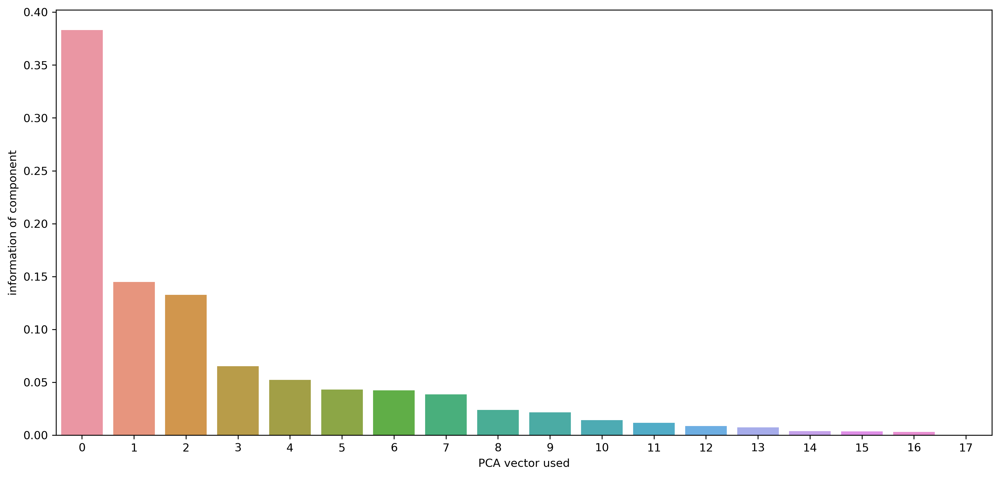

In [16]:
#PCA
from sklearn.decomposition import PCA
import plotly.express as px

pca = PCA(random_state=SEED)
pca.fit(df_v4)

y_information_gain = np.cumsum(pca.explained_variance_ratio_)
data = pd.DataFrame.from_dict({"information of component" : pca.explained_variance_ratio_[0:30],"PCA vector used" : range(y_information_gain.__len__())[0:30]})
plt.figure(figsize=(15,7), dpi=300)
sns.barplot(data=data,x='PCA vector used',y='information of component')

plt.show()

In [17]:
exp_var_cumul = np.cumsum(pca.explained_variance_ratio_)

px.area(
    x=range(1, exp_var_cumul.shape[0] + 1),
    y=exp_var_cumul,
    labels={"x": "Numbers of Components", "y": "Explained Variance"}
)

We can see from th graph that with 6 PC we can express around 82% of the explained variance, since it is a sufficent value we can stop here.
Moreover, as we can see, we choose a number where the graph start to "kneel", after that every PC will explain a lower variance as long as we keep going, so the gain is lower.

In [18]:
import plotly.express as px
from sklearn.decomposition import PCA

features = ["blueWins",
            "blueFirstBlood",
            "blueKills",
            "blueDeaths",
            "blueAssists",
            "blueEliteMonsters",
            "blueDragons",
            "blueTotalGold",
            "blueAvgLevel",
            "blueTotalMinionsKilled",
            "blueGoldDiff",
            "blueExperienceDiff",
            "redAssists",
            "redEliteMonsters",
            "redDragons",
            "redTotalGold",
            "redAvgLevel",
            "redTotalMinionsKilled"]

components = pca.fit_transform(df[features])
labels = {
    str(i): f"PC {i+1} ({var:.1f}%)"
    for i, var in enumerate(pca.explained_variance_ratio_ * 100)
}
plt.figure(figsize=(10, 10))
fig = px.scatter_matrix(
    components,
    labels=labels,
    dimensions=range(6),
    color=df_v3["blueWins"],
    width=1500, height=1500
)
fig.update_traces(diagonal_visible=False)
fig.show()

<Figure size 720x720 with 0 Axes>

Ci permette di comprendere che dato il numero grande di dati non è sempolice ottenere una divisione netta dei dati.
As we can see from the graph above, the great number of instances of the dataset and the absence of features that allow us to divide clearly between the 2 classes leads to overcrowded visual representations of the data.

In [19]:
import plotly.express as px
from sklearn.decomposition import PCA

X = df_v4[["blueFirstBlood",
            "blueKills",
            "blueDeaths",
            "blueAssists",
            "blueEliteMonsters",
            "blueDragons",
            "blueTotalGold",
            "blueAvgLevel",
            "blueTotalMinionsKilled",
            "blueGoldDiff",
            "blueExperienceDiff",
            "redAssists",
            "redEliteMonsters",
            "redDragons",
            "redTotalGold",
            "redAvgLevel",
            "redTotalMinionsKilled"]]

pca = PCA(n_components=2)
components = pca.fit_transform(X)

fig = px.scatter(components, x=0, y=1, color=df_v4['blueWins'])
fig.show()

In [20]:
import plotly.express as px
from sklearn.decomposition import PCA

pca = PCA(n_components=3)
components = pca.fit_transform(X)

total_var = pca.explained_variance_ratio_.sum() * 100

fig = px.scatter_3d(
    components, x=0, y=1, z=2, color=df_v4['blueWins'],
    title=f'Total Explained Variance: {total_var:.2f}%',
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'},
    width=1500, height=1500
)
fig.show()

The 3D version of the graph allow us to see some sort of "layer" division of the data, and if we zoom in we can see a more clear division (and outliers)

Comparison of differently preprocessed datasets for classification
Before starting the classification, we want to see which dataset is the best in terms of accuracy of the class prediction.
To do that, we apply one classifier to the different version of the dataset. 
We decided to use the Random Forest classifier because it is considered as a great baseline model.

The following different versions of the dataset are investigated:
Full dataset
Dataset with variables reduced by our assumptions during the EDA (boxplots, histograms, correlation matrix)
Dataset reduced by considering the first 6 principal components after applying PCA

In [9]:
df_Y = df["blueWins"]

#Vers 1: Complete df 
df_X = df.drop(["blueWins"], axis=1).astype(float)

#Vers 3: df Reduced Select the attributes of interest to our analysis
df_X_reduced = df_v3.drop(["blueWins"], axis=1)

#Vers 4: df reduced with pca
df_X_std = df_v4.drop(["blueWins"], axis=1)



In [11]:
from sklearn.model_selection import train_test_split, KFold, StratifiedKFold, GridSearchCV, learning_curve

#Splitting data into train and test set 
X_train, X_test, y_train, y_test = train_test_split(df_X, df_Y, test_size=0.2, random_state=SEED)
X_train_reduced, X_test_reduced, y_train_reduced, y_test_reduced = train_test_split(df_X_reduced, df_Y, test_size=0.2, random_state=SEED)
X_train_pca, X_test_pca, y_train_pca, y_test_pca = train_test_split(df_X_std, df_Y, test_size=0.2, random_state=SEED)


To measure the performance of the trained models we used the following metrics:
Classification Report
Confusion Matrix
Roc Curve.

Since we are dealing with a balanced dataset, we decided to use also the Roc Curve (which isn't the best metric for unbalanced datasets), while the confusion matrix and the related f1 score are more all rounder metrics.

In [23]:
#Random Forest
from sklearn.ensemble import RandomForestClassifier

#Random Forest Classifier
clf=RandomForestClassifier(n_estimators=100, random_state=SEED)

In [24]:
param_grid = {
    'n_estimators': [200, 700],
    'max_features': ['auto', 'sqrt', 'log2']
}

#Normal dataset
CV_RandomForest = GridSearchCV(estimator=clf, param_grid=param_grid, scoring="roc_auc", cv= 5)
CV_RandomForest.fit(X_train,y_train);

RandomForest_prob = CV_RandomForest.predict_proba(X_test)
RandomForest_prob = RandomForest_prob[:,-1]

In [25]:
#Reduced dataset
CV_RandomForest_Reduced = GridSearchCV(estimator=clf, param_grid=param_grid, scoring="roc_auc", cv= 5)
CV_RandomForest_Reduced.fit(X_train_reduced,y_train_reduced);

RandomForest_reduced_prob = CV_RandomForest_Reduced.predict_proba(X_test_reduced)
RandomForest_reduced_prob = RandomForest_reduced_prob[:,-1]

In [26]:
#Reduced with pca dataset
CV_RandomForest_PCA = GridSearchCV(estimator=clf, param_grid=param_grid,scoring="roc_auc", cv= 5)
CV_RandomForest_PCA.fit(X_train_pca,y_train_pca);

RandomForest_pca_prob = CV_RandomForest_PCA.predict_proba(X_test_pca)
RandomForest_pca_prob = RandomForest_pca_prob[:,-1]

In [27]:
y_pred = CV_RandomForest.predict(X_test)
y_pred_reduced = CV_RandomForest_Reduced.predict(X_test_reduced)
y_pred_pca = CV_RandomForest_PCA.predict(X_test_pca)

In [28]:
CV_RandomForest.score(X_test,y_test)

0.796093029452153

In [29]:
CV_RandomForest_Reduced.score(X_test_reduced,y_test_reduced)


0.7974513742288537

In [30]:
CV_RandomForest_PCA.score(X_test_pca,y_test_pca)

0.7973176405484619

Since our study case is not medical or something similar in that way (where is crucial to maximize the reduction of FP or FN), we can use the AUC score to check the performance of our classifier

In [31]:
from sklearn.metrics import roc_curve, roc_auc_score

# ROC Curve
RandomForest_fpr, RandomForest_tpr, RandomForest_thresholds = roc_curve(y_test, RandomForest_prob)
RandomForest_fpr_reduced, RandomForest_tpr_reduced, RandomForest_threshold_reduceds = roc_curve(y_test_reduced, RandomForest_reduced_prob)
RandomForest_fpr_pca, RandomForest_tpr_pca, RandomForest_thresholds_pca = roc_curve(y_test_pca, RandomForest_pca_prob)

#AUC Scores
RandomForest_auc = roc_auc_score(y_test, RandomForest_prob)
RandomForest_auc_reduced = roc_auc_score(y_test_reduced, RandomForest_reduced_prob)
RandomForest_auc_pca = roc_auc_score(y_test_pca, RandomForest_pca_prob)

In [32]:
from tabulate import tabulate

auc_table = [
['Version DB Complete   ', RandomForest_auc],
['Reduction DB', RandomForest_auc_reduced ],
['PCA DB', RandomForest_auc_pca ],
] 
print (tabulate(auc_table, headers=["DataSets", "AUC Score"]))

DataSets               AUC Score
-------------------  -----------
Version DB Complete     0.796093
Reduction DB            0.797451
PCA DB                  0.797318


As we can see from the scores, the Random Forest had the best performance with the *migliore ds*, so we are going to use this one for the classification that we are going to perform.

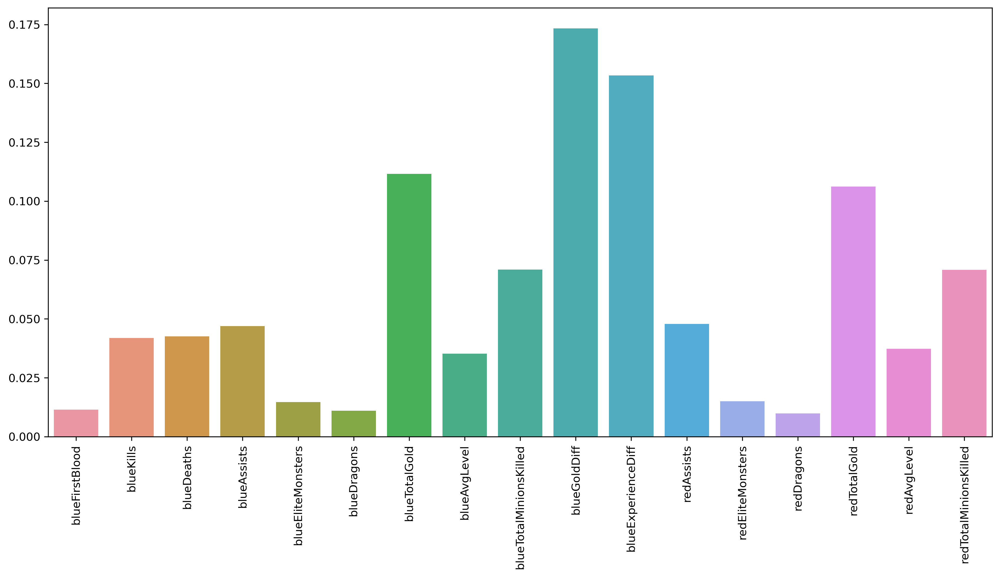

In [33]:
#Extracting the best trained model
import functools

rf = CV_RandomForest_Reduced.best_estimator_

x_val = [x+1 for x in range(rf.feature_importances_.__len__())]
pair_val = []

for key,val in zip(x_val,rf.feature_importances_):
    pair_val.append([key,val])
    
pair_val = sorted(pair_val, key=functools.cmp_to_key(lambda x,y: y[1]-x[1]))
y_val = [x[1] for x in pair_val]
x_val = [x[0] for x in pair_val]
plt.figure(figsize=(15,7), dpi=300)
ax = sns.barplot(y=y_val,x=x_val)
ax.set_xticklabels(df_v3.columns[1:], rotation='vertical', fontsize=10)
plt.show()

As we can see from the graph above, our previous assumptions about the importance of the GoldDifference and the ExperienceDifference were correct and they had the bigger impact during the classification.

Now to evaluate the performance of our classifiers, we are going to check initially the accuracy (from the gridSearch) and then plot both the roc curve and the confusion matrix

In [12]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import plot_confusion_matrix
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import classification_report,confusion_matrix
from sklearn.model_selection import GridSearchCV, cross_val_score
from sklearn import metrics, model_selection
from sklearn.neighbors import KNeighborsClassifier

param_grid = {
    "n_neighbors": [1,3,5,7,9,11,13,15,17,19,21,23,25,31,41,51,89,101,111],
    "weights": ["uniform"],
    "metric": ["euclidean"]}
clf_knn = KNeighborsClassifier()
gs_knn = GridSearchCV(estimator=clf_knn, param_grid=param_grid, scoring="accuracy", cv= 5)
grid_result = gs_knn.fit(X_train_reduced, y_train_reduced)


In [35]:
print(grid_result.best_score_*100)
print(grid_result.best_estimator_)
print(grid_result.best_params_)
allscores=grid_result.cv_results_['mean_test_score']
print(allscores)

72.31449411124188
KNeighborsClassifier(metric='euclidean', n_neighbors=111)
{'metric': 'euclidean', 'n_neighbors': 111, 'weights': 'uniform'}
[0.63279674 0.66708797 0.68606922 0.69821776 0.69783929 0.70467089
 0.70947918 0.71137855 0.7097337  0.71150386 0.70821344 0.71150345
 0.71352821 0.71833626 0.71820943 0.72010761 0.72162627 0.72111994
 0.72314494]


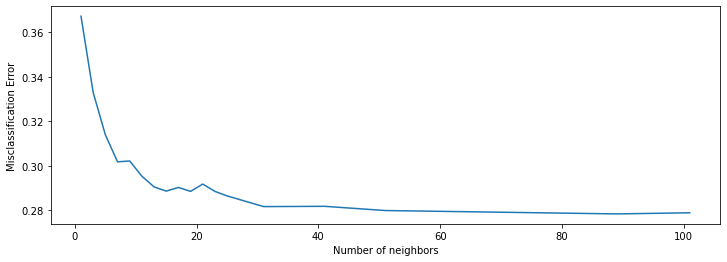

In [36]:
check = [0.63279674, 0.66708797, 0.68606922, 0.69821776, 0.69783929, 0.70467089, 0.70947918, 0.71137855, 0.7097337,  0.71150386, 0.70821344, 0.71150345, 0.71352821, 0.71833626, 0.71820943, 0.72010761, 0.72162627, 0.72111994]
MSE = [1-x for x in check]
neighbors = [1,3,5,7,9,11,13,15,17,19,21,23,25,31,41,51,89,101]
# plot misclassification error versus k 
plt.figure(figsize = (12, 4)) 
plt.plot(neighbors, MSE) 
plt.xlabel('Number of neighbors') 
plt.ylabel('Misclassification Error') 
plt.show()

Graph to show the MSE increase after 89.

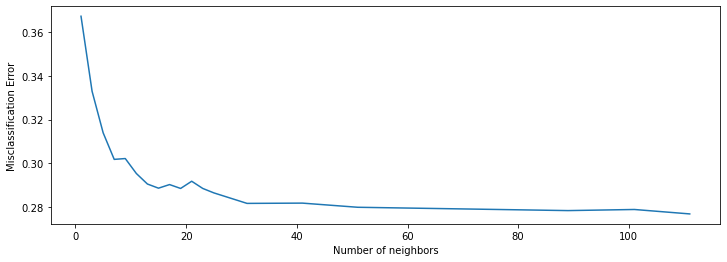

In [37]:
MSE = [1-x for x in allscores]
neighbors = [1,3,5,7,9,11,13,15,17,19,21,23,25,31,41,51,89,101,111]
# plot misclassification error versus k 
plt.figure(figsize = (12, 4)) 
plt.plot(neighbors, MSE) 
plt.xlabel('Number of neighbors') 
plt.ylabel('Misclassification Error') 
plt.show()

As we can see, the MSE has a slight increase at 21 neighbors, then it starts decreasing slowly at each addition.
We decided to experiment the outcome also for 89 neighbors,(square root of the number of instances used for the training set, rule of thumb) and for two values above that number.
It seems that after 89 neighbor the MSE increase again to start another small descent subsequently, because of that we decide that 89 is a good compromise between computational performance and actual outcome.

Testing accuracy: 72.52024291497976
              precision    recall  f1-score   support

           0       0.73      0.71      0.72       970
           1       0.72      0.74      0.73      1006

    accuracy                           0.73      1976
   macro avg       0.73      0.72      0.72      1976
weighted avg       0.73      0.73      0.73      1976



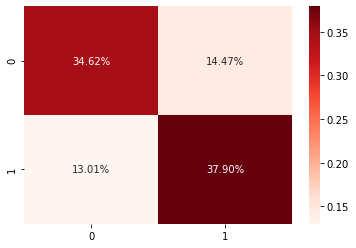

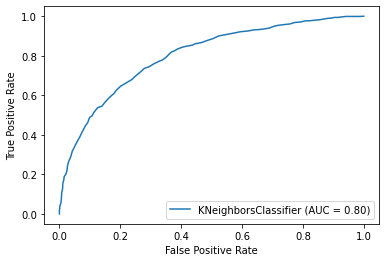

In [63]:
#create a new KNN model with the chosen k parameter
knn_best = KNeighborsClassifier(n_neighbors=89, p=2)
knn_best.fit(X_train_reduced, y_train_reduced)
  
y_pred_reduced = knn_best.predict(X_test_reduced)

print("Testing accuracy:", accuracy_score(y_test_reduced,y_pred_reduced)* 100)
#Classification report
cm = classification_report(y_test_reduced, y_pred_reduced)
print(cm)

#Confusion Matrix 
cm = confusion_matrix(y_test_reduced, y_pred_reduced)
sns.heatmap(cm/np.sum(cm), annot=True, fmt='.2%', cmap='Reds')

#Plot of ROC Curve 
metrics.plot_roc_curve(knn_best, X_test_reduced, y_test_reduced)
plt.show()

In [13]:
from sklearn.svm import SVC

#SVM

# Create the model
clf_svcLinear =SVC(C=10, kernel='linear')

# feeding the training data into the model
clf_svcLinear.fit(X_train_reduced, y_train_reduced)

# predicting the validation set results
y_pred_reduced = clf_svcLinear.predict(X_test_reduced)

# Calculating the accuracies
print("Training accuracy :", clf_svcLinear.score(X_train_reduced, y_train_reduced)*100)
print("Testing accuarcy :", accuracy_score(y_test_reduced,y_pred_reduced)*100)

Training accuracy : 73.27597115019613
Testing accuarcy : 73.12753036437248


In [40]:
# Create the model
clf_svcKernel =SVC(C=10, kernel='rbf',gamma=0.1)

# feeding the training data into the model
clf_svcKernel.fit(X_train_reduced, y_train_reduced)

# predicting the validation set results
y_pred_reduced = clf_svcKernel.predict(X_test_reduced)

# Calculating the accuracies
print("Training accuracy :", clf_svcKernel.score(X_train_reduced, y_train_reduced)*100)
print("Testing accuarcy :", accuracy_score(y_test_reduced,y_pred_reduced)*100)

Training accuracy : 100.0
Validation accuarcy : 49.08906882591093


In [42]:
# using grid search to find the best parameters for svm
from sklearn.model_selection import RandomizedSearchCV

param = {
    'C': [0.8,0.9,1,1.1,1.2,1.3,1.4,10],
    'kernel':['linear', 'rbf'],
    'gamma' :[0.1,0.8,0.9,1,1.1,1.2,1.3,1.4]
}
grid_svc = RandomizedSearchCV(clf_svcKernel, param_distributions = param, scoring = 'accuracy', cv = 5, n_jobs=-1)

In [43]:
grid_svc.fit(X_test_reduced, y_test_reduced)

RandomizedSearchCV(cv=5, estimator=SVC(C=10, gamma=0.1), n_jobs=-1,
                   param_distributions={'C': [0.8, 0.9, 1, 1.1, 1.2, 1.3, 1.4,
                                              10],
                                        'gamma': [0.1, 0.8, 0.9, 1, 1.1, 1.2,
                                                  1.3, 1.4],
                                        'kernel': ['linear', 'rbf']},
                   scoring='accuracy')

In [44]:
grid_svc.best_params_

{'kernel': 'linear', 'gamma': 1, 'C': 1}

Testing accuarcy : 73.78542510121457
              precision    recall  f1-score   support

           0       0.75      0.71      0.73       970
           1       0.73      0.77      0.75      1006

    accuracy                           0.74      1976
   macro avg       0.74      0.74      0.74      1976
weighted avg       0.74      0.74      0.74      1976



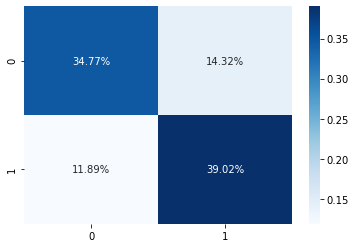

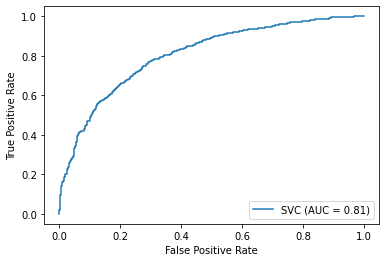

In [61]:
# creating a new SVC model with these best parameters
clf_svcLinear_best = SVC(C = 1, gamma = 1, kernel = 'linear')
clf_svcLinear_best.fit(X_train_reduced, y_train_reduced)
y_pred_reduced = clf_svcLinear_best.predict(X_test_reduced)

#Test Accuracy 
print("Testing accuarcy :", accuracy_score(y_test_reduced,y_pred_reduced)*100)

#Classification Report 
print(classification_report(y_test_reduced, y_pred_reduced))

# Confusion Matrix 
cm = confusion_matrix(y_test_reduced, y_pred_reduced)
sns.heatmap(cm/np.sum(cm), annot=True, fmt='.2%', cmap='Blues')

#Plot of ROC Curve 
metrics.plot_roc_curve(clf_svcLinear_best, X_test_reduced, y_test_reduced)
plt.show()

In [14]:
from sklearn.linear_model import LogisticRegression
#Logistic regression
# creating the model
reg_log = LogisticRegression(random_state = SEED, solver='lbfgs', max_iter=200)

# feeding the training data into the model
reg_log.fit(X_train_reduced, y_train_reduced)

# predicting the validation set results
y_pred_reduced = reg_log.predict(X_test_reduced)

# Calculating the accuracies
print("Training accuracy :", reg_log.score(X_train_reduced, y_train_reduced)*100)
print("Testing accuarcy :", accuracy_score(y_test_reduced,y_pred_reduced)*100)

Training accuracy : 72.71922054915855
Testing accuarcy : 73.22874493927125


In [47]:
# using grid search to find the best parameters for LR

param = {
    'C': [0.001, 0.1, 1, 10, 100]
}
grid_LR = GridSearchCV(reg_log, param_grid = param, scoring = 'accuracy', cv = 5)

grid_LR.fit(X_train_reduced, y_train_reduced) #Check

GridSearchCV(cv=5, estimator=LogisticRegression(max_iter=200, random_state=28),
             param_grid={'C': [0.001, 0.1, 1, 10, 100]}, scoring='accuracy')

In [48]:
grid_LR.best_params_

{'C': 10}

Testing accuarcy : 73.22874493927125
              precision    recall  f1-score   support

           0       0.74      0.71      0.72       970
           1       0.73      0.75      0.74      1006

    accuracy                           0.73      1976
   macro avg       0.73      0.73      0.73      1976
weighted avg       0.73      0.73      0.73      1976



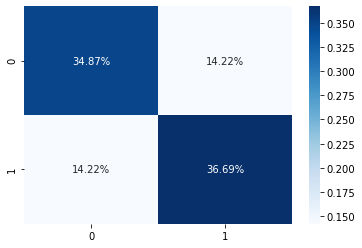

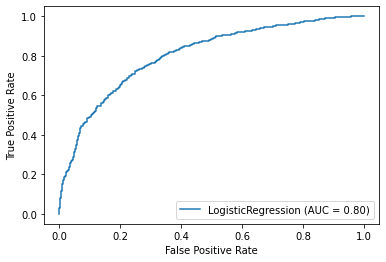

In [49]:
# creating a new LR model with these best parameter C
rg_logBest= LogisticRegression(C=10)
rg_logBest.fit(X_train_reduced, y_train_reduced)
y_pred_reduced = rg_logBest.predict(X_test_reduced)
print("Testing accuarcy :", accuracy_score(y_test_reduced,y_pred_reduced)*100)

# classification report
cr = classification_report(y_test_reduced, y_pred_reduced)
print(cr)

# Confusion Matrix 
cm = confusion_matrix(y_test, y_pred)
sns.heatmap(cm/np.sum(cm), annot=True, fmt='.2%', cmap='Blues')

#Plot of ROC Curve 
metrics.plot_roc_curve(rg_logBest, X_test_reduced, y_test_reduced)
plt.show()

In [15]:
from sklearn import tree
from sklearn.tree import DecisionTreeClassifier
#Decision Tree
# Creating a model
clf_dt = DecisionTreeClassifier()

# feeding the training set into the model
clf_dt.fit(X_train_reduced, y_train_reduced)

# predicting the validation set results
y_pred_reduced = clf_dt.predict(X_test_reduced)#check

# Calculating the accuracies
print("Training accuracy :", clf_dt.score(X_train_reduced, y_train_reduced)*100)
print("Testing accuarcy :", accuracy_score(y_test_reduced,y_pred_reduced)*100)

Training accuracy : 100.0
Testing accuarcy : 63.81578947368421


In [51]:
# using grid search to find the best parameters for Decision Tree

param = {
    'criterion':['entropy', 'gini'],
    'max_depth':[10, 50, 100]
}
grid_DT = GridSearchCV(clf_dt, param_grid = param, scoring = 'accuracy', cv = 5)

grid_DT.fit(X_train_reduced, y_train_reduced)

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(),
             param_grid={'criterion': ['entropy', 'gini'],
                         'max_depth': [10, 50, 100]},
             scoring='accuracy')

In [52]:
grid_DT.best_params_

{'criterion': 'entropy', 'max_depth': 10}

Testing accuarcy : 71.15384615384616
              precision    recall  f1-score   support

           0       0.72      0.68      0.70       970
           1       0.71      0.74      0.72      1006

    accuracy                           0.71      1976
   macro avg       0.71      0.71      0.71      1976
weighted avg       0.71      0.71      0.71      1976



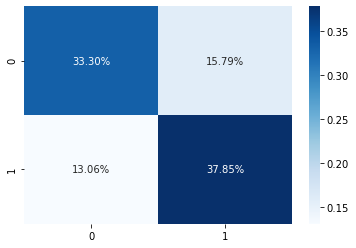

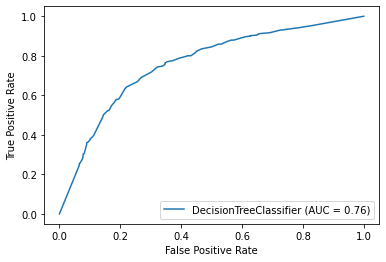

In [53]:
#creating a new Decison Tree model with these best parameters

clf_dtBest= DecisionTreeClassifier(criterion ='entropy', max_depth =10 ,random_state=SEED)
clf_dtBest.fit(X_train_reduced, y_train_reduced)
y_pred_reduced = clf_dtBest.predict(X_test_reduced)
print("Testing accuarcy :", accuracy_score(y_test_reduced,y_pred_reduced)*100)

# classification report
cr = classification_report(y_test_reduced, y_pred_reduced)
print(cr)

# Confusion Matrix 
cm = confusion_matrix(y_test_reduced, y_pred_reduced)
sns.heatmap(cm/np.sum(cm), annot=True, fmt='.2%', cmap='Blues')

#Plot of ROC Curve 
metrics.plot_roc_curve(clf_dtBest, X_test_reduced, y_test_reduced)
plt.show()

In [58]:
#Visualizing the decison Tree
import graphviz
fig = plt.figure(figsize=(300,100)) 
tree.plot_tree(clf_dtBest, feature_names=df_v3.columns ,class_names='blueWins', filled=True, fontsize=40)
plt.show()

In [56]:
#Random Forest
# creating a model
clf_RF = RandomForestClassifier()

# feeding the training set into the model
clf_RF.fit(X_train_reduced, y_train_reduced)

# predicting the validation set results
y_pred = clf_RF.predict(X_train_reduced)

# Calculating the accuracies
print("Training accuracy :", clf_RF.score(X_train_reduced, y_train_reduced)*100)
print("Testing accuarcy :", accuracy_score(y_test_reduced,y_pred_reduced)*100)

Training accuracy : 100.0
Validation accuarcy : 71.15384615384616


Randomized velocizza drasticamente il calcolo rispetto al GridSearch

In [57]:
from sklearn.model_selection import RandomizedSearchCV
param = {"n_estimators": np.arange(10,100,5),
              "min_samples_split": np.arange(2,100,2),
              "criterion": ["gini", "entropy"],
              "max_depth" :np.arange(10,100,10),
              "max_features":['auto', 'sqrt'],
              "bootstrap":[True,False]
              }
grid_RF = RandomizedSearchCV(clf_RF, param_distributions = param, scoring = 'accuracy', cv = 5)
grid_RF.fit(X_train_reduced, y_train_reduced)

RandomizedSearchCV(cv=5, estimator=RandomForestClassifier(),
                   param_distributions={'bootstrap': [True, False],
                                        'criterion': ['gini', 'entropy'],
                                        'max_depth': array([10, 20, 30, 40, 50, 60, 70, 80, 90]),
                                        'max_features': ['auto', 'sqrt'],
                                        'min_samples_split': array([ 2,  4,  6,  8, 10, 12, 14, 16, 18, 20, 22, 24, 26, 28, 30, 32, 34,
       36, 38, 40, 42, 44, 46, 48, 50, 52, 54, 56, 58, 60, 62, 64, 66, 68,
       70, 72, 74, 76, 78, 80, 82, 84, 86, 88, 90, 92, 94, 96, 98]),
                                        'n_estimators': array([10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90,
       95])},
                   scoring='accuracy')

In [59]:
grid_RF.best_params_

{'n_estimators': 45,
 'min_samples_split': 92,
 'max_features': 'sqrt',
 'max_depth': 80,
 'criterion': 'entropy',
 'bootstrap': False}

Testing accuarcy : 72.36842105263158
              precision    recall  f1-score   support

           0       0.72      0.72      0.72       970
           1       0.73      0.73      0.73      1006

    accuracy                           0.72      1976
   macro avg       0.72      0.72      0.72      1976
weighted avg       0.72      0.72      0.72      1976



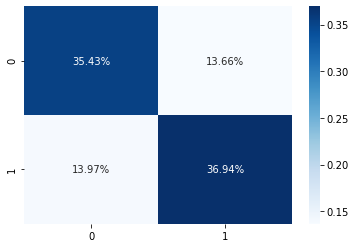

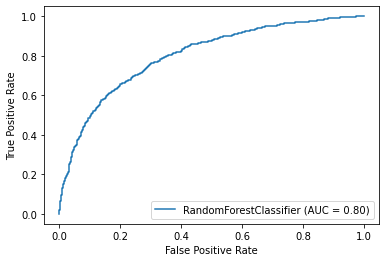

In [62]:
clf_RF_Best= RandomForestClassifier(bootstrap='False',criterion ='entropy', max_depth=80,max_features='sqrt',min_samples_split =92,n_estimators= 45,random_state=SEED)
clf_RF_Best.fit(X_train_reduced, y_train_reduced)
y_pred_reduced = clf_RF_Best.predict(X_test_reduced)
print("Testing accuarcy :",accuracy_score(y_test_reduced,y_pred_reduced)*100)

# classification report
cr = classification_report(y_test_reduced, y_pred_reduced)
print(cr)

# Confusion Matrix 
cm = confusion_matrix(y_test_reduced, y_pred_reduced)
sns.heatmap(cm/np.sum(cm), annot=True, fmt='.2%', cmap='Blues')

#Plot of ROC Curve 
metrics.plot_roc_curve(clf_RF_Best, X_test_reduced, y_test_reduced)
plt.show()